In [1]:
import torch
import os
import cv2


In [2]:
import torch
import os
import cv2

class MosquitoDataset(torch.utils.data.Dataset):
    def __init__(self, images_dir, labels_dir, img_size=640):
        self.images_dir = images_dir
        self.labels_dir = labels_dir
        self.image_files = [f for f in os.listdir(images_dir) if f.endswith(".jpeg")]
        self.img_size = img_size  # Resize images to this size

    def __len__(self):
        return len(self.image_files)

    def convert_yolo_to_pascal(self, label_file, img_width, img_height, new_width, new_height):
        """Convert YOLO annotations to Pascal VOC format and adjust for resized dimensions."""
        converted_labels = []
        scale_x = new_width / img_width
        scale_y = new_height / img_height

        with open(label_file, 'r') as file:
            for line in file:
                class_id, center_x, center_y, width, height = map(float, line.strip().split())

                # Convert YOLO (center_x, center_y, width, height) to Pascal VOC (x_min, y_min, x_max, y_max)
                x_min = (center_x - width / 2) * img_width
                y_min = (center_y - height / 2) * img_height
                x_max = (center_x + width / 2) * img_width
                y_max = (center_y + height / 2) * img_height

                # Adjust bounding box to the new image size
                x_min *= scale_x
                y_min *= scale_y
                x_max *= scale_x
                y_max *= scale_y

                converted_labels.append([class_id, x_min, y_min, x_max, y_max])

        return converted_labels

    def __getitem__(self, idx):
        # Image file path
        img_name = self.image_files[idx]
        img_path = os.path.join(self.images_dir, img_name)
        label_path = os.path.join(self.labels_dir, img_name.replace(".jpeg", ".txt"))

        # Load image
        img = cv2.imread(img_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        # Get original dimensions
        orig_height, orig_width, _ = img.shape

        # Resize the image
        img = cv2.resize(img, (self.img_size, self.img_size))
        new_height, new_width = self.img_size, self.img_size

        # Convert YOLO annotations to Pascal VOC and adjust for resized dimensions
        pascal_labels = self.convert_yolo_to_pascal(label_path, orig_width, orig_height, new_width, new_height)

        boxes = []
        labels = []
        for label in pascal_labels:
            class_id, x_min, y_min, x_max, y_max = label
            boxes.append([x_min, y_min, x_max, y_max])
            labels.append(class_id)

        boxes = torch.tensor(boxes, dtype=torch.float32)
        labels = torch.tensor(labels, dtype=torch.int64)

        target = {"boxes": boxes, "labels": labels}

        # Convert image to PyTorch tensor
        img = torch.tensor(img, dtype=torch.float32).permute(2, 0, 1) / 255.0  # Normalize to [0, 1]

        return img, target


In [3]:
import torchvision
from torchvision.models.detection import ssd300_vgg16
from torchvision.models.detection.ssd import SSDClassificationHead, SSDRegressionHead
import torch

def get_ssd_model(num_classes):
    # Load the pre-trained SSD model
    model = ssd300_vgg16(weights="DEFAULT")

    # Generate a dummy input to pass through the backbone
    dummy_input = torch.rand(1, 3, 300, 300)  # Batch size 1, RGB image, 300x300 resolution

    # Pass the dummy input through the backbone
    feature_maps = model.backbone(dummy_input)

    # Determine the output channels for each feature map
    out_channels = [feature.shape[1] for feature in feature_maps.values()]

    # Generate the number of anchors per location
    num_anchors = model.anchor_generator.num_anchors_per_location()

    # Replace the classification head with updated dimensions
    model.head.classification_head = SSDClassificationHead(out_channels, num_anchors, num_classes)

    # Replace the regression head (bbox prediction)
    model.head.regression_head = SSDRegressionHead(out_channels, num_anchors)

    return model

# Define the number of classes (including background)
num_classes = 7  # 6 mosquito classes + 1 background
model = get_ssd_model(num_classes)


In [ ]:
from torch.utils.data import DataLoader

# Initialize the dataset
train_dataset = MosquitoDataset("./datasets/dataset/images/train", "./datasets/dataset/labels/train", img_size=300)
val_dataset = MosquitoDataset("./datasets/dataset/images/val", "./datasets/dataset/labels/val", img_size=300)

train_loader = DataLoader(
    train_dataset, batch_size=8, shuffle=True, collate_fn=lambda x: tuple(zip(*x))
)

val_loader = DataLoader(
    val_dataset, batch_size=8, shuffle=False, collate_fn=lambda x: tuple(zip(*x))
)

In [5]:
test_dataset = MosquitoDataset("./datasets/dataset/images/test", "./datasets/dataset/labels/test", img_size=300)
test_loader = DataLoader(
    test_dataset, batch_size=8, shuffle=False, collate_fn=lambda x: tuple(zip(*x))
)

In [6]:
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
model.to(device)

# Optimizer
optimizer = torch.optim.SGD(model.parameters(), lr=0.001, momentum=0.9, weight_decay=0.0005)

# Learning rate scheduler
lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=3, gamma=0.1)


In [24]:
from tqdm import tqdm

num_epochs = 10
for epoch in range(num_epochs):
    model.train()
    epoch_loss = 0

    for images, targets in tqdm(train_loader):
        # Move data to the GPU
        images = list(img.to(device) for img in images)
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

        # Forward pass
        loss_dict = model(images, targets)
        losses = sum(loss for loss in loss_dict.values())

        # Backward pass and optimization
        optimizer.zero_grad()
        losses.backward()
        optimizer.step()

        epoch_loss += losses.item()

    print(f"Epoch [{epoch+1}/{num_epochs}], Loss: {epoch_loss:.4f}")

    # Update the learning rate
    lr_scheduler.step()


100%|██████████| 826/826 [09:55<00:00,  1.39it/s]


Epoch [1/10], Loss: 3063.9789


100%|██████████| 826/826 [10:56<00:00,  1.26it/s]


Epoch [2/10], Loss: 2681.2417


100%|██████████| 826/826 [09:48<00:00,  1.40it/s]


Epoch [3/10], Loss: 2068.8317


100%|██████████| 826/826 [10:36<00:00,  1.30it/s]


Epoch [4/10], Loss: 1925.7232


100%|██████████| 826/826 [10:34<00:00,  1.30it/s]


Epoch [5/10], Loss: 1828.9390


100%|██████████| 826/826 [10:36<00:00,  1.30it/s]


Epoch [6/10], Loss: 1720.8605


100%|██████████| 826/826 [09:54<00:00,  1.39it/s]


Epoch [7/10], Loss: 1702.0566


100%|██████████| 826/826 [09:47<00:00,  1.41it/s]


Epoch [8/10], Loss: 1685.8293


100%|██████████| 826/826 [09:31<00:00,  1.45it/s]


Epoch [9/10], Loss: 1673.1438


100%|██████████| 826/826 [09:48<00:00,  1.40it/s]

Epoch [10/10], Loss: 1675.5859


In [ ]:
import torch
import os
from tqdm import tqdm

def train_ssd_model(model, train_loader, optimizer, lr_scheduler, num_epochs, device, save_dir="models"):
    """
    Train an SSD model and save the best model based on the lowest training loss.

    Args:
        model: PyTorch SSD model.
        train_loader: DataLoader for training data.
        optimizer: Optimizer for the model.
        lr_scheduler: Learning rate scheduler.
        num_epochs: Number of training epochs.
        device: Device to run the training (e.g., "cuda" or "cpu").
        save_dir: Directory to save the model checkpoints.

    Returns:
        None
    """
    os.makedirs(save_dir, exist_ok=True)  # Create directory to save models
    best_loss = float('inf')  # Initialize best loss

    for epoch in range(num_epochs):
        model.train()  # Set model to training mode
        epoch_loss = 0

        for images, targets in tqdm(train_loader, desc=f"Epoch {epoch+1}/{num_epochs}"):
            # Move data to the GPU/CPU
            images = list(img.to(device) for img in images)
            targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

            # Forward pass
            loss_dict = model(images, targets)
            losses = sum(loss for loss in loss_dict.values())

            # Backward pass and optimization
            optimizer.zero_grad()
            losses.backward()
            optimizer.step()

            epoch_loss += losses.item()

        # Print epoch loss
        print(f"Epoch [{epoch+1}/{num_epochs}], Loss: {epoch_loss:.4f}")

        # Save model checkpoint for the current epoch
        checkpoint_path = os.path.join(save_dir, f"ssd_epoch_{epoch+1}.pth")
        torch.save(model.state_dict(), checkpoint_path)
        print(f"Saved checkpoint: {checkpoint_path}")

        # Check for best model
        if epoch_loss < best_loss:
            best_loss = epoch_loss
            best_model_path = os.path.join(save_dir, "ssd_best_model.pth")
            torch.save(model.state_dict(), best_model_path)
            print(f"Updated best model: {best_model_path}")

        # Update the learning rate
        lr_scheduler.step()



In [ ]:
# Example usage
train_ssd_model(
    model=model,
    train_loader=train_loader,
    optimizer=optimizer,
    lr_scheduler=lr_scheduler,
    num_epochs=10,
    device=device,
    save_dir="ssd_models"
)

In [25]:
# Evaluation mode
model.eval()

with torch.no_grad():
    for images, _ in val_loader:
        images = [img.to(device) for img in images]

        # Forward pass (returns predictions)
        outputs = model(images)

        for output in outputs:
            print("Predicted Boxes:", output["boxes"])
            print("Predicted Labels:", output["labels"])
            print("Confidence Scores:", output["scores"])


Predicted Boxes: tensor([[108.8269,  99.9459, 213.3233, 166.2383],
        [111.7310, 102.9144, 214.7863, 165.9931],
        [114.7700,  99.5390, 214.2961, 162.7208],
        [108.8269,  99.9459, 213.3233, 166.2383],
        [112.1079,  99.5515, 216.6567, 163.5508]], device='cuda:0')
Predicted Labels: tensor([3, 1, 4, 5, 2], device='cuda:0')
Confidence Scores: tensor([0.5049, 0.3120, 0.1436, 0.0684, 0.0423], device='cuda:0')
Predicted Boxes: tensor([[ 89.8100, 107.4390, 230.4906, 185.9766],
        [ 89.3453, 104.3859, 228.7000, 190.2555],
        [135.7142, 144.3729, 220.9386, 181.3444],
        [ 68.7059,  34.9359, 264.1608, 182.1234],
        [ 86.6434, 100.8096, 234.9481, 186.8087],
        [ 89.9501, 106.7644, 231.2502, 185.2318],
        [ 89.9501, 106.7644, 231.2502, 185.2318],
        [ 68.7059,  34.9359, 264.1608, 182.1234],
        [176.0054,  21.0876, 253.1773,  91.3022],
        [205.0968,  70.2466, 278.3482, 140.0411],
        [ 88.7946, 106.7042, 129.5499, 140.7545],
    

KeyboardInterrupt: 

In [26]:
for images, labels in train_loader:
    print(images, labels)
    break

(tensor([[[0.2745, 0.1059, 0.2549,  ..., 0.4706, 0.5490, 0.5451],
         [0.1569, 0.2196, 0.1961,  ..., 0.4510, 0.4980, 0.5882],
         [0.2118, 0.2196, 0.2275,  ..., 0.5333, 0.5137, 0.5686],
         ...,
         [0.5843, 0.6196, 0.5373,  ..., 0.5686, 0.6000, 0.5647],
         [0.5490, 0.5686, 0.5529,  ..., 0.5882, 0.5804, 0.6157],
         [0.5843, 0.5882, 0.5176,  ..., 0.5882, 0.5569, 0.5922]],

        [[0.2745, 0.1059, 0.2549,  ..., 0.3961, 0.4745, 0.4824],
         [0.2157, 0.2706, 0.1961,  ..., 0.3804, 0.4667, 0.4627],
         [0.2118, 0.2196, 0.2275,  ..., 0.4627, 0.4824, 0.5529],
         ...,
         [0.5098, 0.5451, 0.4627,  ..., 0.4941, 0.5294, 0.5255],
         [0.5216, 0.5373, 0.4784,  ..., 0.5608, 0.5529, 0.5373],
         [0.5569, 0.5569, 0.4431,  ..., 0.5608, 0.4824, 0.5255]],

        [[0.2745, 0.1059, 0.2549,  ..., 0.3373, 0.4157, 0.3804],
         [0.1882, 0.2471, 0.1961,  ..., 0.3216, 0.3922, 0.4235],
         [0.2118, 0.2196, 0.2275,  ..., 0.4039, 0.4078, 0

In [7]:
model.load_state_dict(torch.load("ssd_models/ssd_best_model.pth"))

C:\Users\aryam\AppData\Local\Temp\ipykernel_50208\517401441.py:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load("ssd_models/ssd_best_model.p

<All keys matched successfully>

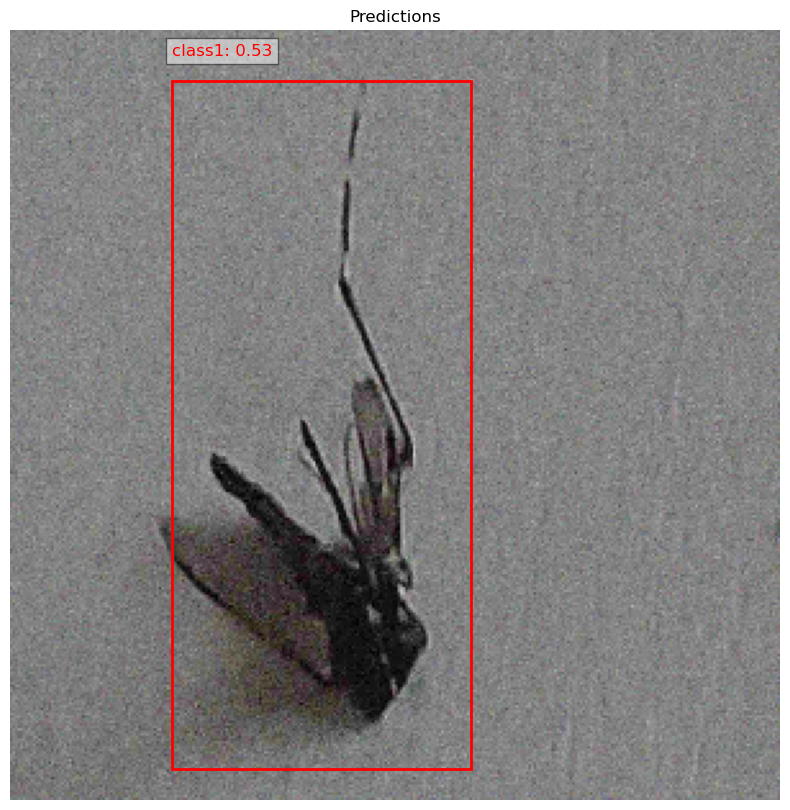

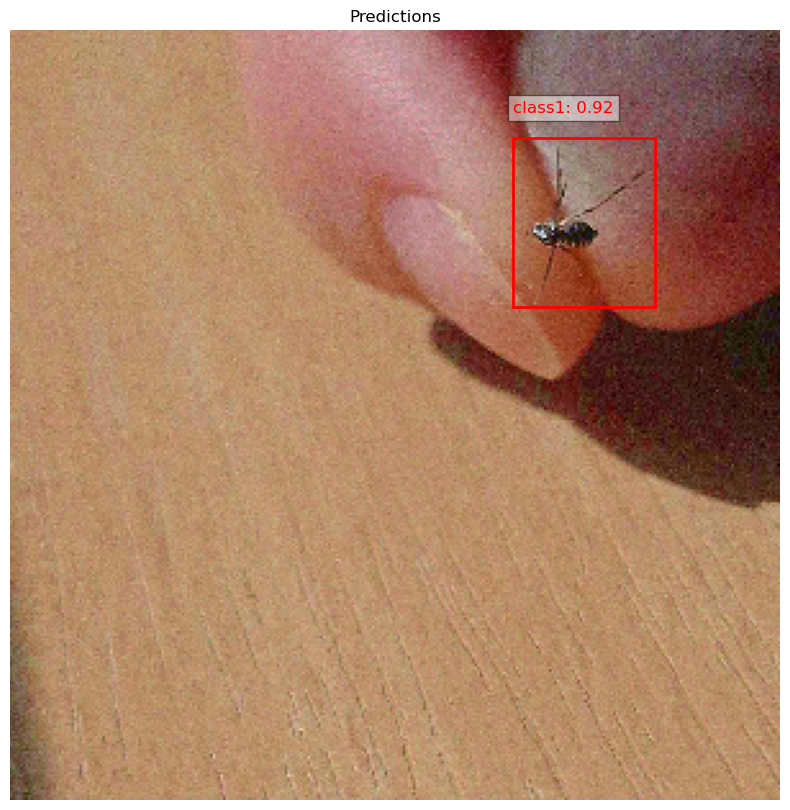

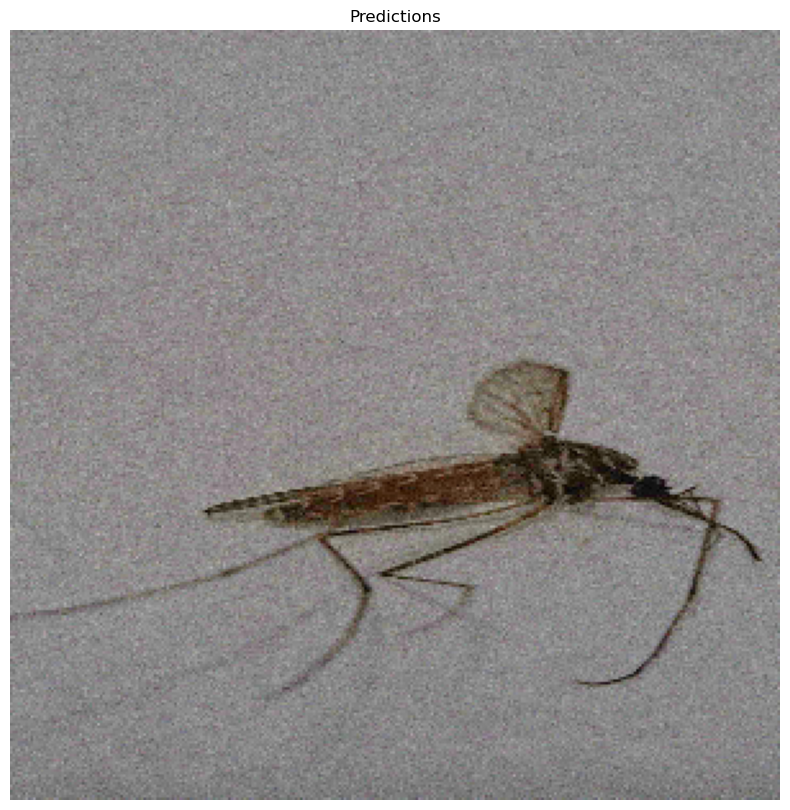

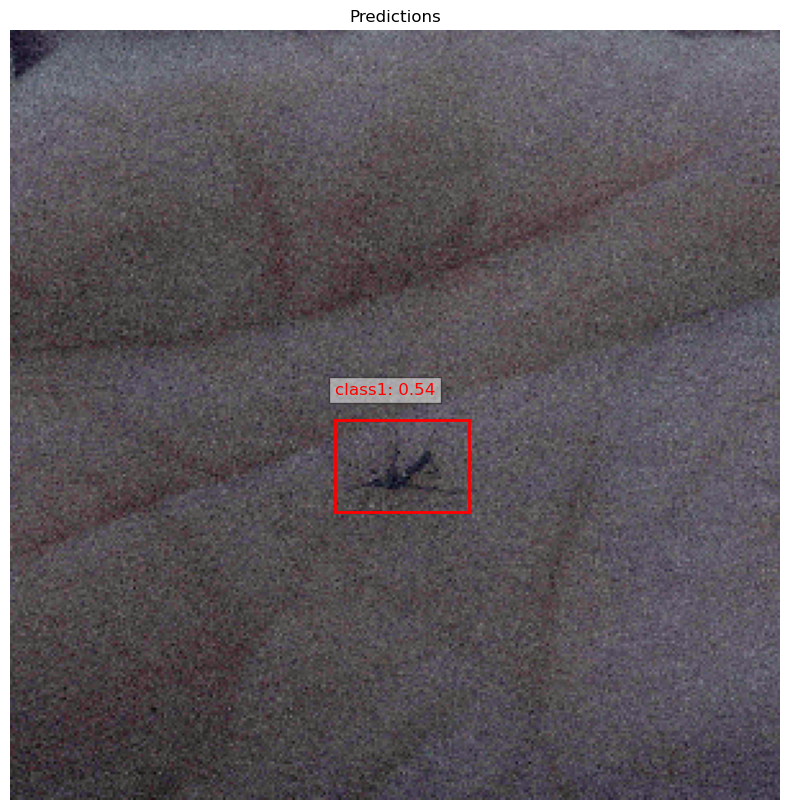

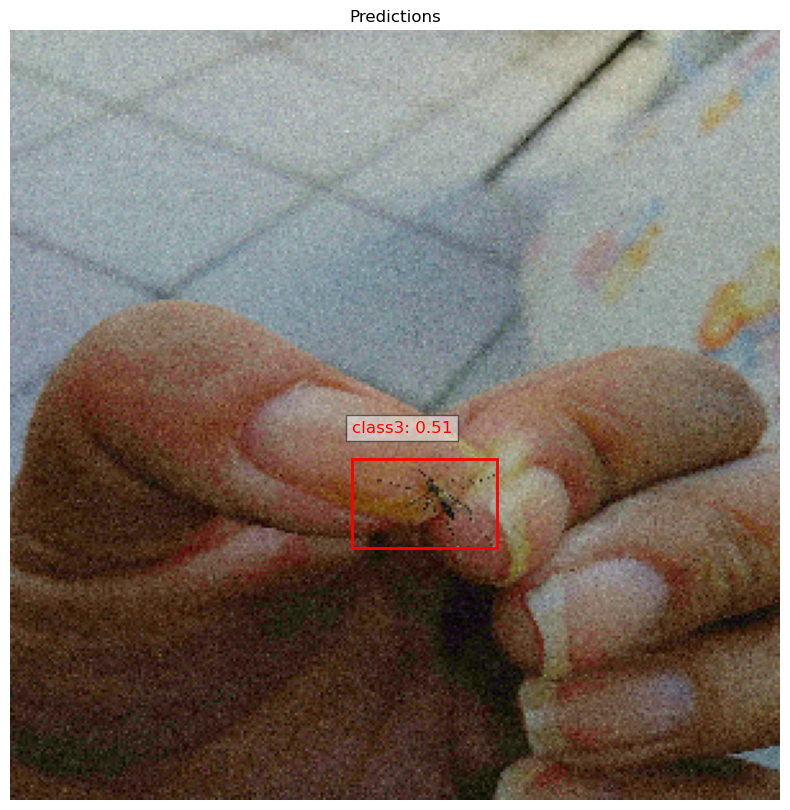

In [8]:
import matplotlib.pyplot as plt
import cv2
import random
from torchvision.transforms.functional import to_pil_image

def plot_predictions(model, data_loader, device, class_labels, num_samples=5):
    """
    Plot bounding boxes and class predictions for samples from the validation dataset.
    
    Args:
        model: Trained SSD model.
        data_loader: DataLoader for validation data.
        device: Device for computation (e.g., "cuda" or "cpu").
        class_labels: List of class labels corresponding to class IDs.
        num_samples: Number of samples to visualize.
    """
    model.eval()  # Set model to evaluation mode
    samples = random.sample(range(len(data_loader.dataset)), num_samples)  # Randomly select samples

    with torch.no_grad():
        for idx in samples:
            # Load the image and target from the dataset
            img, target = data_loader.dataset[idx]

            # Move the image to the device
            img = img.to(device).unsqueeze(0)  # Add batch dimension

            # Get model predictions
            output = model(img)[0]  # Model returns a list of outputs

            # Extract boxes, labels, and scores
            boxes = output["boxes"].cpu().numpy()
            labels = output["labels"].cpu().numpy()
            scores = output["scores"].cpu().numpy()

            # Convert the image tensor to a PIL image for plotting
            img = to_pil_image(img.squeeze(0).cpu())

            # Plot the image with bounding boxes
            plt.figure(figsize=(10, 10))
            plt.imshow(img)
            ax = plt.gca()

            for box, label, score in zip(boxes, labels, scores):
                if score > 0.5:  # Plot only confident predictions
                    x_min, y_min, x_max, y_max = box

                    # Draw the bounding box
                    rect = plt.Rectangle((x_min, y_min), x_max - x_min, y_max - y_min, 
                                         edgecolor="red", facecolor="none", linewidth=2)
                    ax.add_patch(rect)

                    # Add the label and score
                    label_text = f"{class_labels[label]}: {score:.2f}"
                    ax.text(x_min, y_min - 10, label_text, color="red", fontsize=12, 
                            backgroundcolor="white", bbox=dict(facecolor="white", alpha=0.5))

            plt.axis("off")
            plt.title("Predictions")
            plt.show()

# Example usage
class_labels = ["background", "class1", "class2", "class3", "class4", "class5", "class6"]  # Replace with your class names
plot_predictions(model, val_loader, device, class_labels, num_samples=5)


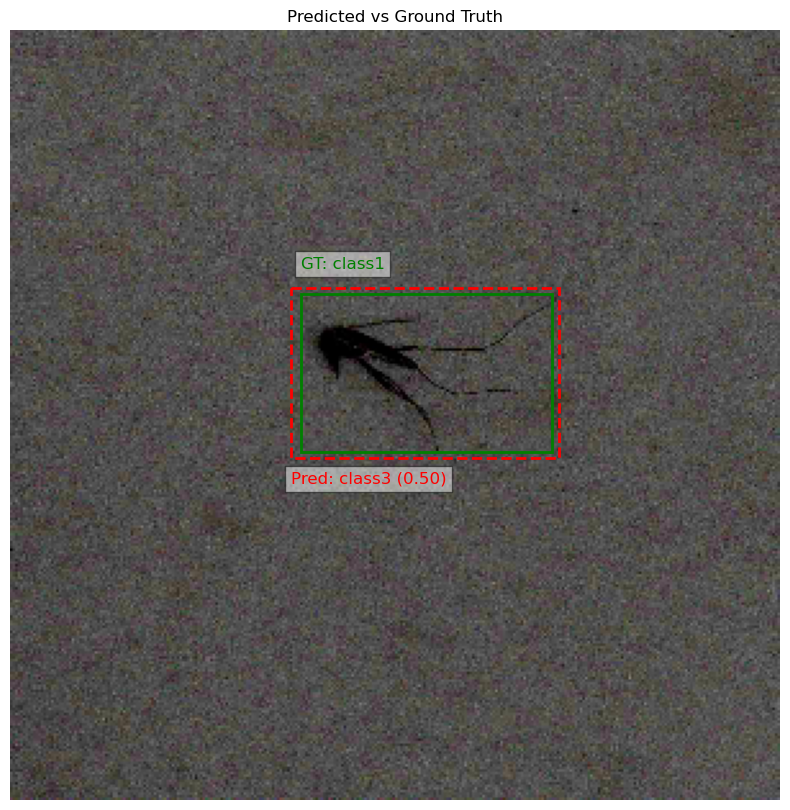

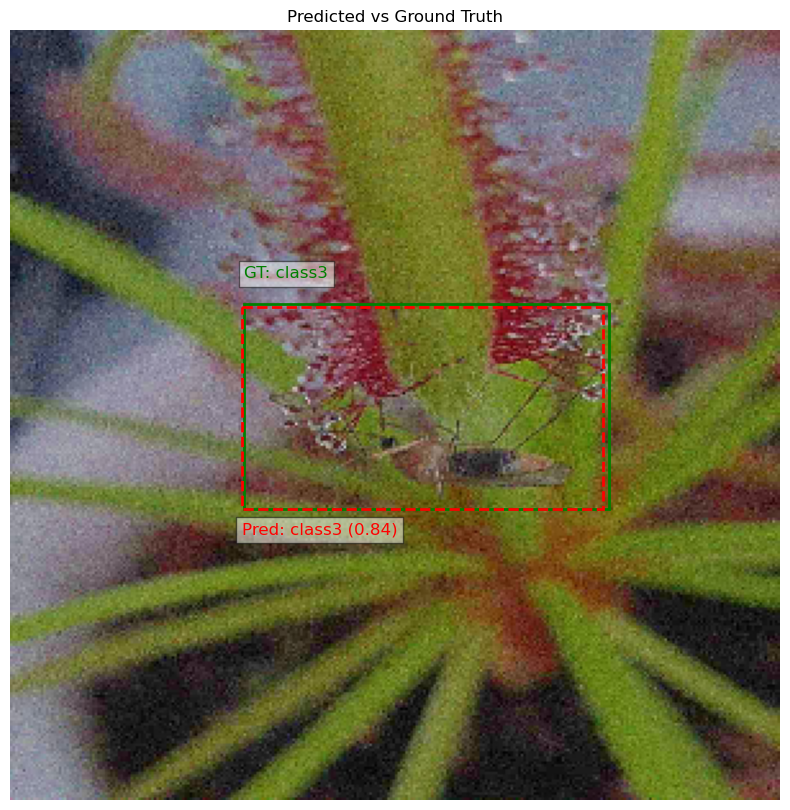

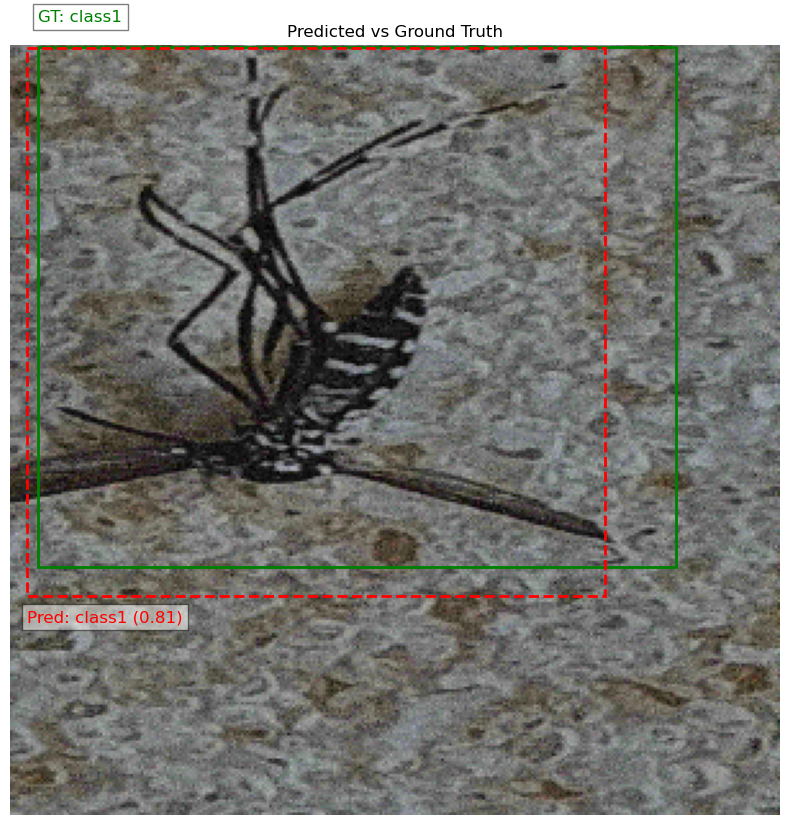

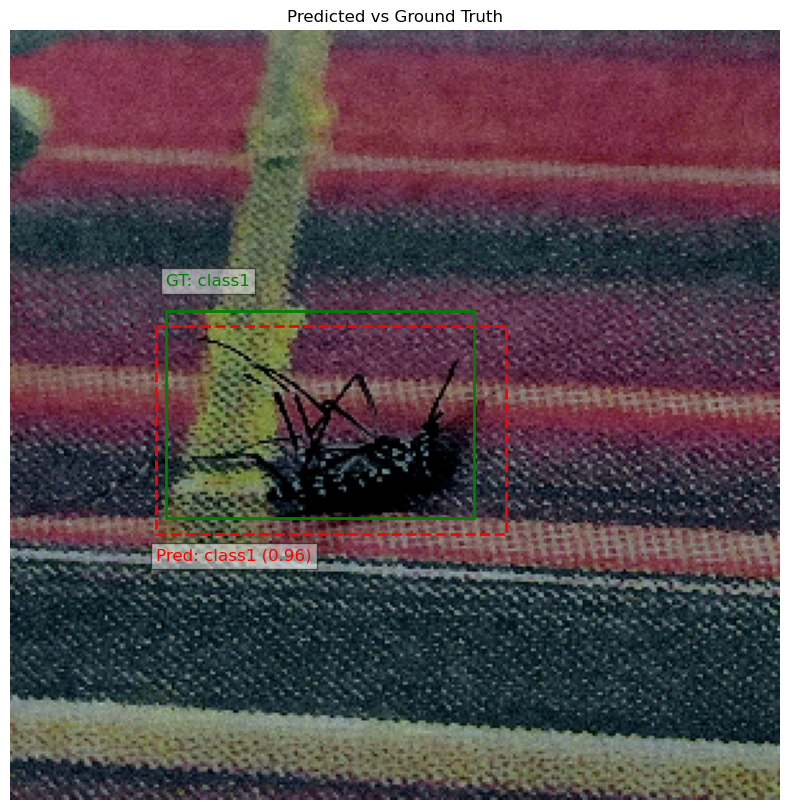

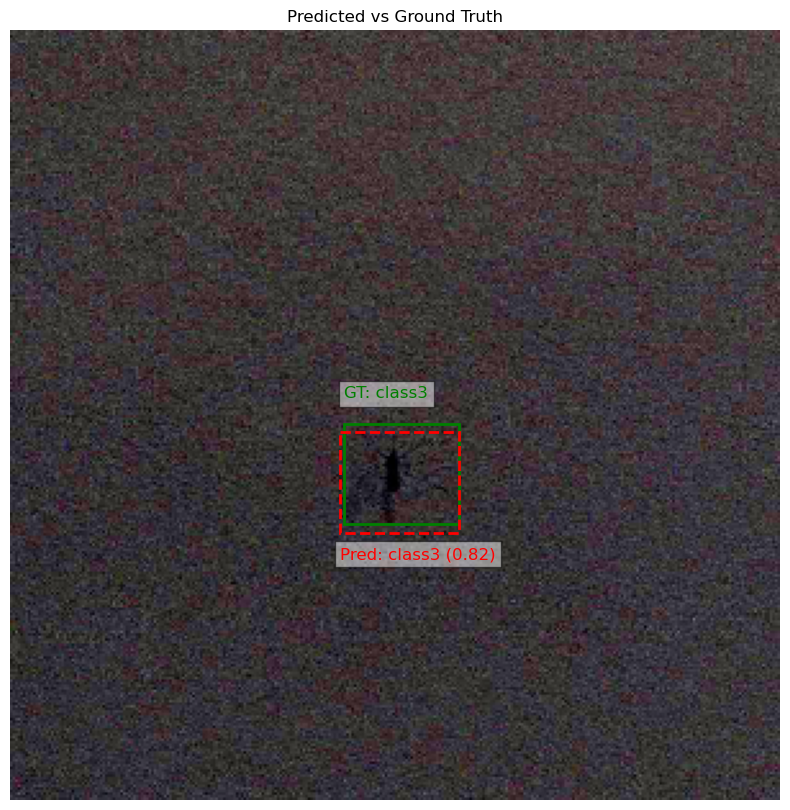

In [9]:
import matplotlib.pyplot as plt
import cv2
from torchvision.transforms.functional import to_pil_image

def plot_predictions_vs_ground_truth(model, data_loader, device, class_labels, num_samples=5):
    """
    Plot predicted and ground truth bounding boxes and labels for samples from the validation dataset.
    
    Args:
        model: Trained SSD model.
        data_loader: DataLoader for validation data.
        device: Device for computation (e.g., "cuda" or "cpu").
        class_labels: List of class labels corresponding to class IDs.
        num_samples: Number of samples to visualize.
    """
    model.eval()  # Set model to evaluation mode

    with torch.no_grad():
        for idx in range(num_samples):
            # Load the image and target from the dataset
            img, target = data_loader.dataset[idx]

            # Move the image to the device
            img = img.to(device).unsqueeze(0)  # Add batch dimension

            # Get model predictions
            output = model(img)[0]  # Model returns a list of outputs

            # Extract predictions
            pred_boxes = output["boxes"].cpu().numpy()
            pred_labels = output["labels"].cpu().numpy()
            pred_scores = output["scores"].cpu().numpy()

            # Extract ground truth
            true_boxes = target["boxes"].cpu().numpy()
            true_labels = target["labels"].cpu().numpy()

            # Convert the image tensor to a PIL image for plotting
            img = to_pil_image(img.squeeze(0).cpu())

            # Plot the image with bounding boxes
            plt.figure(figsize=(10, 10))
            plt.imshow(img)
            ax = plt.gca()

            # Plot ground truth bounding boxes
            for box, label in zip(true_boxes, true_labels):
                x_min, y_min, x_max, y_max = box

                # Draw the bounding box (green for ground truth)
                rect = plt.Rectangle((x_min, y_min), x_max - x_min, y_max - y_min, 
                                     edgecolor="green", facecolor="none", linewidth=2)
                ax.add_patch(rect)

                # Add the label
                label_text = f"GT: {class_labels[label]}"
                ax.text(x_min, y_min - 10, label_text, color="green", fontsize=12, 
                        backgroundcolor="white", bbox=dict(facecolor="white", alpha=0.5))

            # Plot predicted bounding boxes
            for box, label, score in zip(pred_boxes, pred_labels, pred_scores):
                if score > 0.5:  # Plot only confident predictions
                    x_min, y_min, x_max, y_max = box

                    # Draw the bounding box (red for predictions)
                    rect = plt.Rectangle((x_min, y_min), x_max - x_min, y_max - y_min, 
                                         edgecolor="red", facecolor="none", linewidth=2, linestyle="--")
                    ax.add_patch(rect)

                    # Add the label and score
                    label_text = f"Pred: {class_labels[label]} ({score:.2f})"
                    ax.text(x_min, y_max + 10, label_text, color="red", fontsize=12, 
                            backgroundcolor="white", bbox=dict(facecolor="white", alpha=0.5))

            plt.axis("off")
            plt.title("Predicted vs Ground Truth")
            plt.show()

# Example usage
class_labels = ["background", "class1", "class2", "class3", "class4", "class5", "class6"]  # Replace with your class names
plot_predictions_vs_ground_truth(model, val_loader, device, class_labels, num_samples=5)


In [34]:
# import os
# from torchvision.transforms.functional import to_pil_image
# import matplotlib.pyplot as plt
# import torch
# import cv2

# def plot_test_predictions_no_loader(model, test_folder, device, class_labels, num_samples=5):
#     """
#     Plot bounding boxes and class predictions for test images directly from the test folder (no loader).
    
#     Args:
#         model: Trained SSD model.
#         test_folder: Path to the test image folder.
#         device: Device for computation (e.g., "cuda" or "cpu").
#         class_labels: List of class labels corresponding to class IDs.
#         num_samples: Number of samples to visualize.
#     """
#     model.eval()  # Set model to evaluation mode

#     # Get test image paths
#     image_paths = [os.path.join(test_folder, f) for f in os.listdir(test_folder) if f.endswith((".jpeg", ".png"))]
#     selected_images = image_paths[:num_samples]  # Select the first `num_samples` images

#     with torch.no_grad():
#         for image_path in selected_images:
#             # Load the image
#             img = cv2.imread(image_path)
#             img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

#             # Resize and normalize the image (300x300 for SSD)
#             img_resized = cv2.resize(img, (300, 300))
#             img_tensor = torch.tensor(img_resized, dtype=torch.float32).permute(2, 0, 1) / 255.0  # Normalize to [0, 1]
#             img_tensor = img_tensor.unsqueeze(0).to(device)  # Add batch dimension

#             # Get model predictions
#             output = model(img_tensor)[0]  # Model returns a list of outputs

#             # Extract predictions
#             pred_boxes = output["boxes"].cpu().numpy()
#             pred_labels = output["labels"].cpu().numpy()
#             pred_scores = output["scores"].cpu().numpy()

#             # Plot the image with bounding boxes
#             plt.figure(figsize=(10, 10))
#             plt.imshow(img)
#             ax = plt.gca()

#             # Plot predicted bounding boxes
#             for box, label, score in zip(pred_boxes, pred_labels, pred_scores):
#                 if score > 0.5:  # Plot only confident predictions
#                     x_min, y_min, x_max, y_max = box

#                     # Draw the bounding box (red for predictions)
#                     rect = plt.Rectangle((x_min, y_min), x_max - x_min, y_max - y_min, 
#                                          edgecolor="red", facecolor="none", linewidth=2, linestyle="--")
#                     ax.add_patch(rect)

#                     # Add the label and score
#                     label_text = f"Pred: {class_labels[label]} ({score:.2f})"
#                     ax.text(x_min, y_min - 10, label_text, color="red", fontsize=12, 
#                             backgroundcolor="white", bbox=dict(facecolor="white", alpha=0.5))

#             plt.axis("off")
#             plt.title(f"Predictions for {os.path.basename(image_path)}")
#             plt.show()

# # Example usage
# test_folder = "./datasets/dataset/images/test"  # Path to the test images folder
# class_labels = ["background", "class1", "class2", "class3", "class4", "class5", "class6"]  # Replace with your class names
# plot_test_predictions_no_loader(model, test_folder, device, class_labels, num_samples=5)


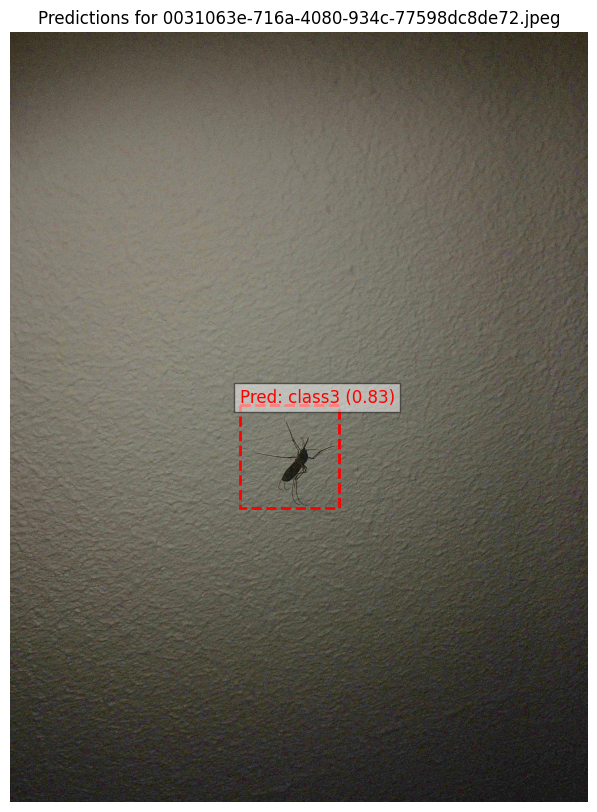

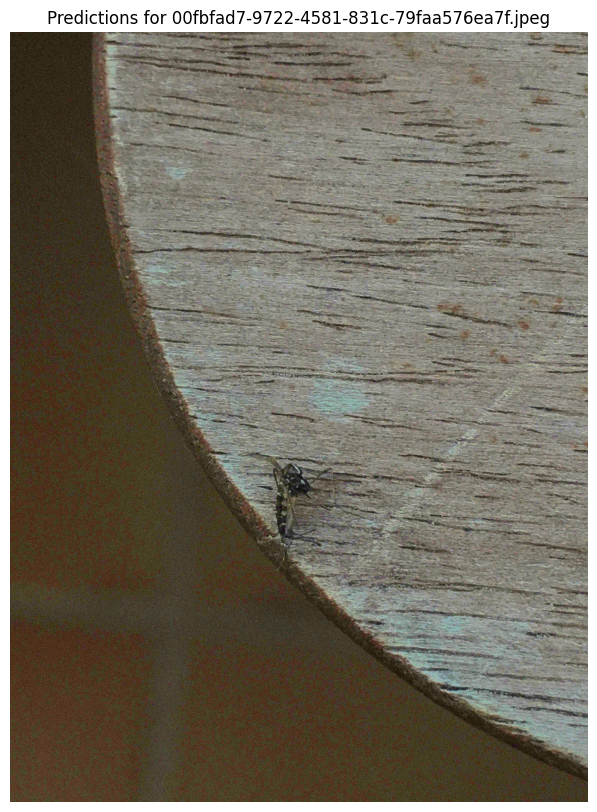

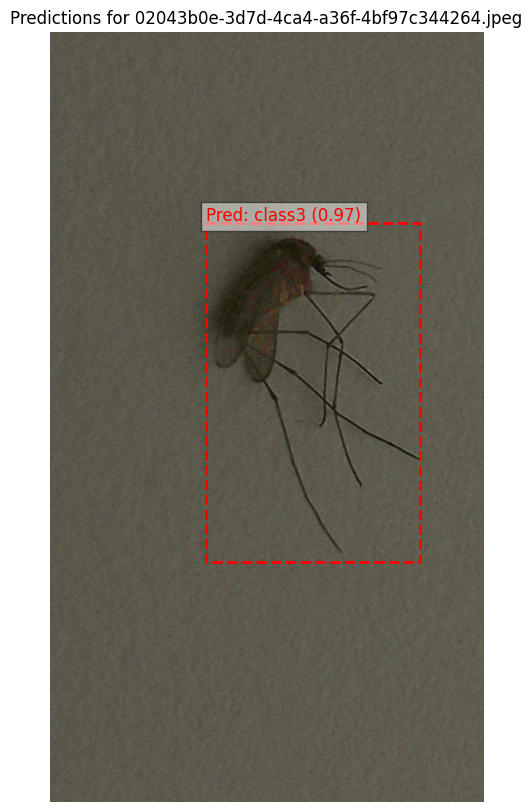

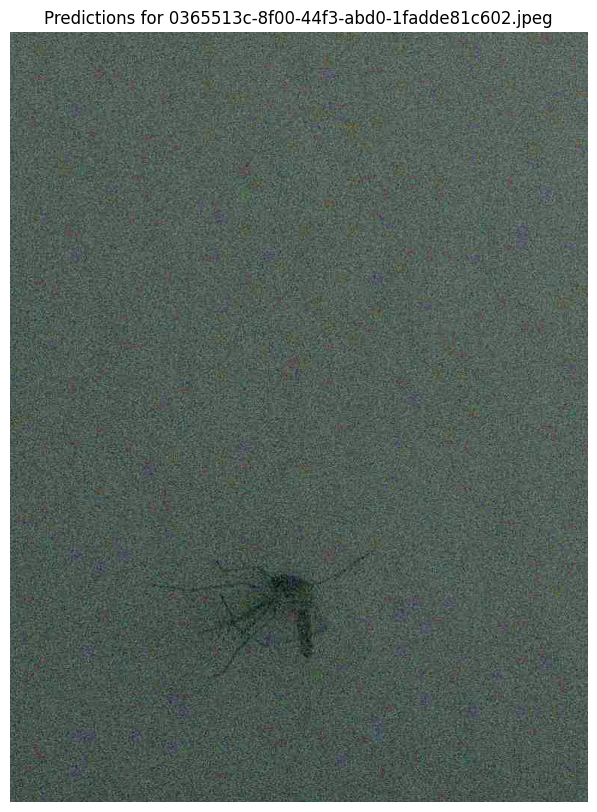

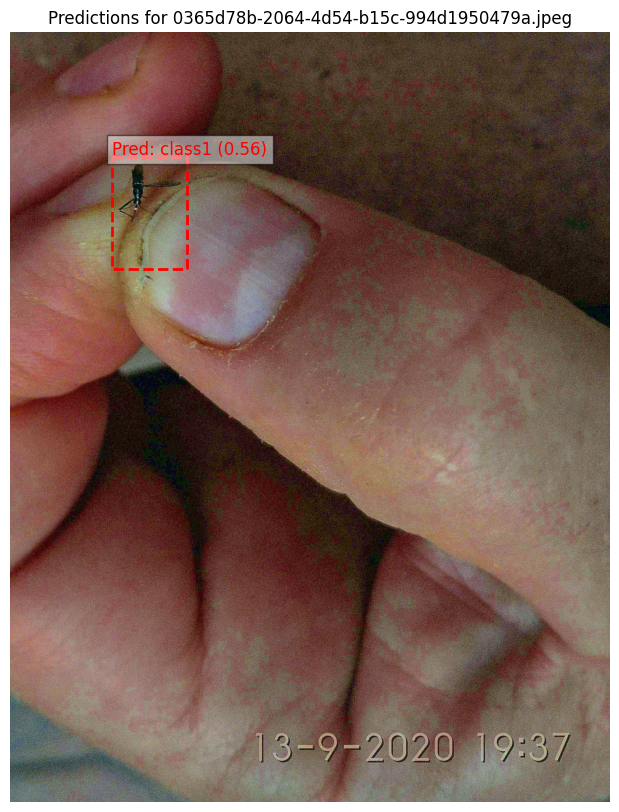

In [33]:
def plot_test_predictions_with_rescaling(model, test_folder, device, class_labels, num_samples=5):
    """
    Plot bounding boxes and class predictions for test images directly from the test folder (no loader).
    The bounding boxes are rescaled back to the original image dimensions for correct visualization.
    
    Args:
        model: Trained SSD model.
        test_folder: Path to the test image folder.
        device: Device for computation (e.g., "cuda" or "cpu").
        class_labels: List of class labels corresponding to class IDs.
        num_samples: Number of samples to visualize.
    """
    model.eval()  # Set model to evaluation mode

    # Get test image paths
    image_paths = [os.path.join(test_folder, f) for f in os.listdir(test_folder) if f.endswith((".jpeg", ".png"))]
    selected_images = image_paths[:num_samples]  # Select the first `num_samples` images

    with torch.no_grad():
        for image_path in selected_images:
            # Load the original image
            img = cv2.imread(image_path)
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            orig_height, orig_width, _ = img.shape

            # Resize and normalize the image (300x300 for SSD)
            img_resized = cv2.resize(img, (300, 300))
            img_tensor = torch.tensor(img_resized, dtype=torch.float32).permute(2, 0, 1) / 255.0  # Normalize to [0, 1]
            img_tensor = img_tensor.unsqueeze(0).to(device)  # Add batch dimension

            # Get model predictions
            output = model(img_tensor)[0]  # Model returns a list of outputs

            # Extract predictions
            pred_boxes = output["boxes"].cpu().numpy()
            pred_labels = output["labels"].cpu().numpy()
            pred_scores = output["scores"].cpu().numpy()

            # Rescale bounding boxes to the original image size
            scale_x = orig_width / 300
            scale_y = orig_height / 300
            pred_boxes_rescaled = []
            for box in pred_boxes:
                x_min, y_min, x_max, y_max = box
                x_min *= scale_x
                y_min *= scale_y
                x_max *= scale_x
                y_max *= scale_y
                pred_boxes_rescaled.append([x_min, y_min, x_max, y_max])

            # Plot the image with bounding boxes
            plt.figure(figsize=(10, 10))
            plt.imshow(img)
            ax = plt.gca()

            # Plot predicted bounding boxes
            for box, label, score in zip(pred_boxes_rescaled, pred_labels, pred_scores):
                if score > 0.5:  # Plot only confident predictions
                    x_min, y_min, x_max, y_max = box

                    # Draw the bounding box (red for predictions)
                    rect = plt.Rectangle((x_min, y_min), x_max - x_min, y_max - y_min, 
                                         edgecolor="red", facecolor="none", linewidth=2, linestyle="--")
                    ax.add_patch(rect)

                    # Add the label and score
                    label_text = f"Pred: {class_labels[label]} ({score:.2f})"
                    ax.text(x_min, y_min - 10, label_text, color="red", fontsize=12, 
                            backgroundcolor="white", bbox=dict(facecolor="white", alpha=0.5))

            plt.axis("off")
            plt.title(f"Predictions for {os.path.basename(image_path)}")
            plt.show()

# Example usage
test_folder = "./datasets/dataset/images/test"  # Path to the test images folder
class_labels = ["background", "class1", "class2", "class3", "class4", "class5", "class6"]  # Replace with your class names
plot_test_predictions_with_rescaling(model, test_folder, device, class_labels, num_samples=5)


In [10]:
import torch
from torchvision.ops import box_iou
import numpy as np
from tqdm import tqdm

In [11]:
def calculate_f1_score(pred_boxes, pred_labels, pred_scores, true_boxes, true_labels, iou_threshold=0.5, score_threshold=0.5):
    """
    Calculate F1 score for a single image's predictions.

    Args:
        pred_boxes: Predicted bounding boxes (N x 4, numpy array).
        pred_labels: Predicted class labels (N, numpy array).
        pred_scores: Predicted confidence scores (N, numpy array).
        true_boxes: Ground truth bounding boxes (M x 4, numpy array).
        true_labels: Ground truth class labels (M, numpy array).
        iou_threshold: IoU threshold for matching predictions to ground truth.
        score_threshold: Confidence score threshold for valid predictions.

    Returns:
        tp: True positives.
        fp: False positives.
        fn: False negatives.
    """
    # Filter predictions based on confidence score
    valid_preds = pred_scores > score_threshold
    pred_boxes = pred_boxes[valid_preds]
    pred_labels = pred_labels[valid_preds]
    
    # Initialize counters
    tp = 0
    fp = 0
    fn = 0

    # Match predictions to ground truth
    if len(pred_boxes) > 0 and len(true_boxes) > 0:
        ious = box_iou(torch.tensor(pred_boxes), torch.tensor(true_boxes))
        max_ious, max_indices = ious.max(dim=1)

        for pred_idx, max_iou in enumerate(max_ious):
            if max_iou > iou_threshold and pred_labels[pred_idx] == true_labels[max_indices[pred_idx]]:
                tp += 1
            else:
                fp += 1

        # Count false negatives (unmatched ground truth boxes)
        matched_gt = max_ious > iou_threshold
        fn = len(true_boxes) - matched_gt.sum().item()
    else:
        # All predictions are false positives if no ground truth exists
        fp = len(pred_boxes)
        # All ground truth boxes are false negatives if no predictions exist
        fn = len(true_boxes)

    return tp, fp, fn


In [12]:
def calculate_map(pred_boxes, pred_labels, pred_scores, true_boxes, true_labels, iou_threshold=0.5):
    """
    Calculate Mean Average Precision (mAP) for a single image's predictions.

    Args:
        pred_boxes: Predicted bounding boxes (N x 4, numpy array).
        pred_labels: Predicted class labels (N, numpy array).
        pred_scores: Predicted confidence scores (N, numpy array).
        true_boxes: Ground truth bounding boxes (M x 4, numpy array).
        true_labels: Ground truth class labels (M, numpy array).
        iou_threshold: IoU threshold for matching predictions to ground truth.

    Returns:
        Average precision for this image.
    """
    if len(pred_boxes) == 0 or len(true_boxes) == 0:
        return 0.0

    # Sort predictions by confidence score (descending)
    sorted_indices = np.argsort(-pred_scores)
    pred_boxes = pred_boxes[sorted_indices]
    pred_labels = pred_labels[sorted_indices]

    ious = box_iou(torch.tensor(pred_boxes), torch.tensor(true_boxes))

    tp = np.zeros(len(pred_boxes))
    fp = np.zeros(len(pred_boxes))
    matched_gt = np.zeros(len(true_boxes), dtype=bool)

    for i, box in enumerate(pred_boxes):
        if len(true_boxes) == 0:
            fp[i] = 1
            continue

        # Find the highest IoU for this prediction
        max_iou, max_idx = ious[i].max(0)
        if max_iou >= iou_threshold and not matched_gt[max_idx] and pred_labels[i] == true_labels[max_idx]:
            tp[i] = 1
            matched_gt[max_idx] = True
        else:
            fp[i] = 1

    # Cumulative sums for precision/recall
    tp_cumsum = np.cumsum(tp)
    fp_cumsum = np.cumsum(fp)

    precisions = tp_cumsum / (tp_cumsum + fp_cumsum + 1e-6)
    recalls = tp_cumsum / len(true_boxes)

    # Average Precision (AP)
    ap = 0.0
    for t in np.linspace(0, 1, 11):  # Standard mAP evaluation at 11 points
        if np.sum(recalls >= t) == 0:
            p = 0
        else:
            p = np.max(precisions[recalls >= t])
        ap += p / 11

    return ap


In [13]:
def evaluate_model(model, data_loader, device, iou_threshold=0.5, score_threshold=0.5):
    """
    Evaluate F1 Score and Mean Average Precision (mAP) for the validation dataset.

    Args:
        model: Trained SSD model.
        data_loader: DataLoader for validation data.
        device: Device for computation (e.g., "cuda" or "cpu").
        iou_threshold: IoU threshold for matching predictions to ground truth.
        score_threshold: Confidence score threshold for valid predictions.

    Returns:
        f1_score: Overall F1 Score for the dataset.
        mean_ap: Mean Average Precision (mAP) for the dataset.
    """
    model.eval()  # Set model to evaluation mode

    all_tp, all_fp, all_fn = 0, 0, 0
    all_aps = []

    with torch.no_grad():
        for images, targets in tqdm(data_loader, desc="Evaluating"):
            # Move data to device
            images = [img.to(device) for img in images]
            targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

            # Get model predictions
            outputs = model(images)

            for output, target in zip(outputs, targets):
                # Predicted values
                pred_boxes = output["boxes"].cpu().numpy()
                pred_labels = output["labels"].cpu().numpy()
                pred_scores = output["scores"].cpu().numpy()

                # Ground truth values
                true_boxes = target["boxes"].cpu().numpy()
                true_labels = target["labels"].cpu().numpy()

                # Calculate F1 components
                tp, fp, fn = calculate_f1_score(pred_boxes, pred_labels, pred_scores, 
                                                true_boxes, true_labels, 
                                                iou_threshold, score_threshold)
                all_tp += tp
                all_fp += fp
                all_fn += fn

                # Calculate AP for this image
                ap = calculate_map(pred_boxes, pred_labels, pred_scores, 
                                   true_boxes, true_labels, 
                                   iou_threshold)
                all_aps.append(ap)

    # F1 Score Calculation
    precision = all_tp / (all_tp + all_fp + 1e-6)
    recall = all_tp / (all_tp + all_fn + 1e-6)
    f1_score = 2 * (precision * recall) / (precision + recall + 1e-6)

    # Mean Average Precision
    mean_ap = np.mean(all_aps)

    return f1_score, mean_ap

# Example usage
f1, map_score = evaluate_model(model, val_loader, device, iou_threshold=0.5, score_threshold=0.5)
print(f"F1 Score: {f1:.4f}, mAP: {map_score:.4f}")


Evaluating: 100%|██████████| 142/142 [01:29<00:00,  1.58it/s]

F1 Score: 0.7792, mAP: 0.8160


In [14]:
# Example usage
f1, map_score = evaluate_model(model, test_loader, device, iou_threshold=0.5, score_threshold=0.5)
print(f"F1 Score: {f1:.4f}, mAP: {map_score:.4f}")

Evaluating: 100%|██████████| 66/66 [00:36<00:00,  1.82it/s]

F1 Score: 0.7559, mAP: 0.7986


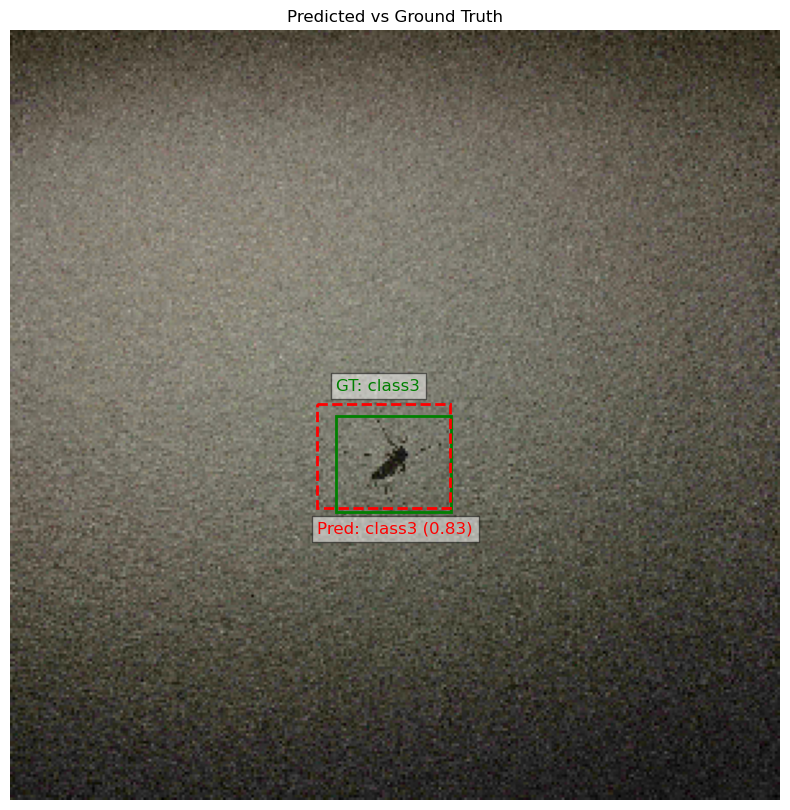

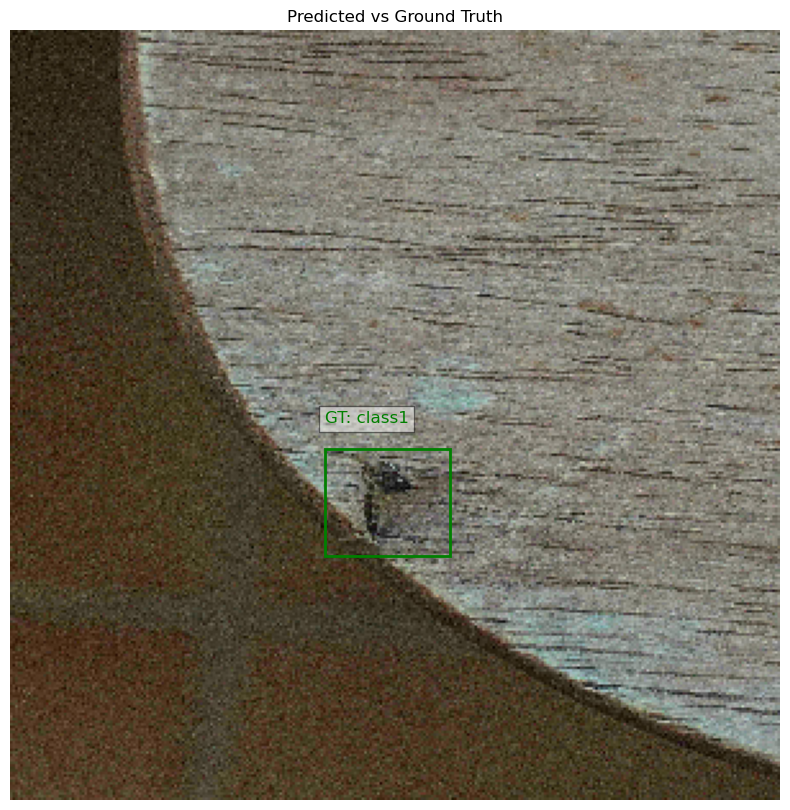

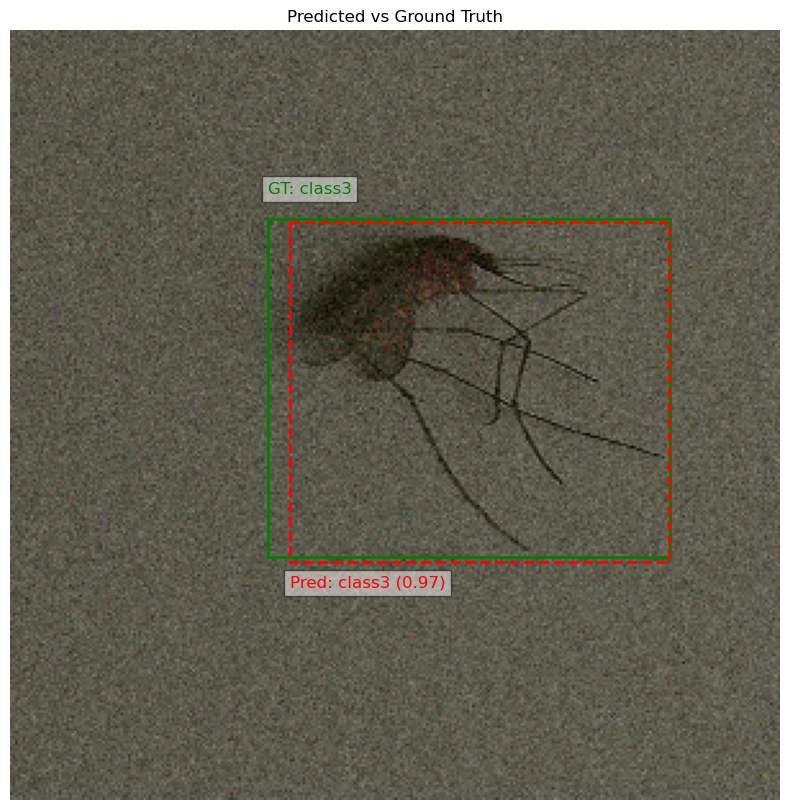

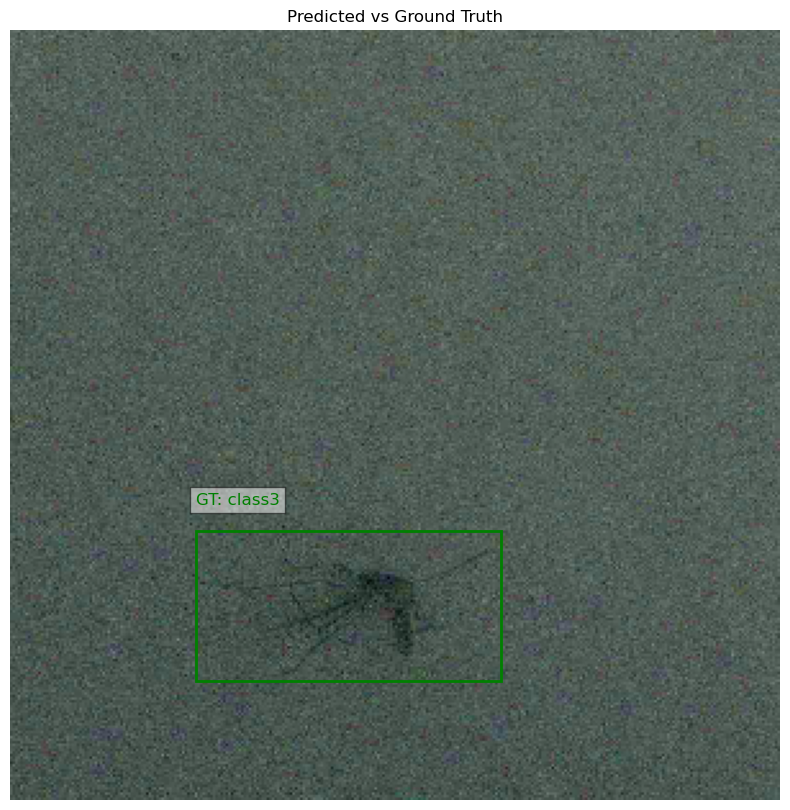

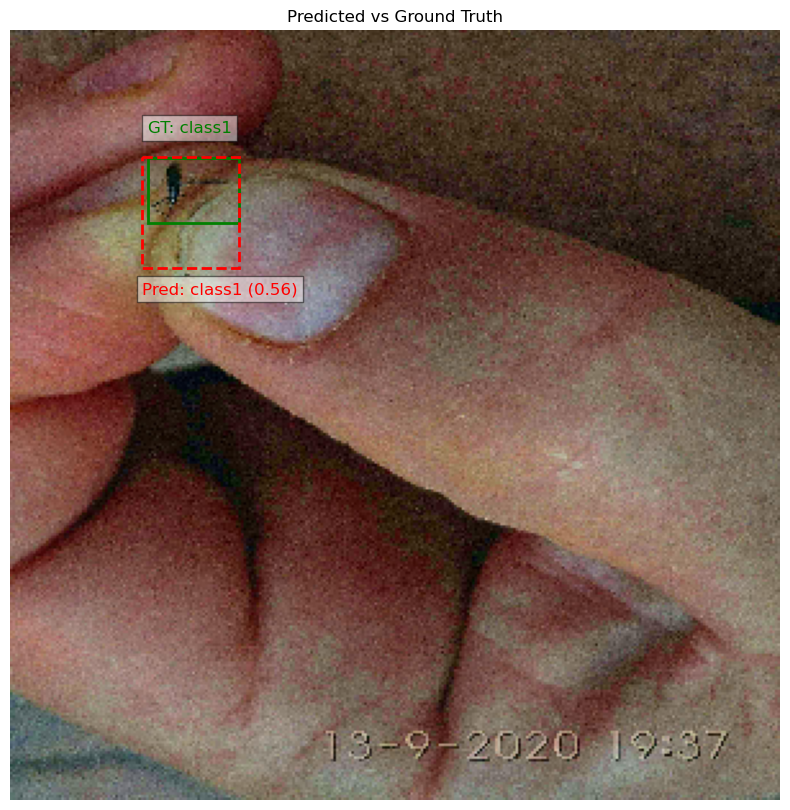

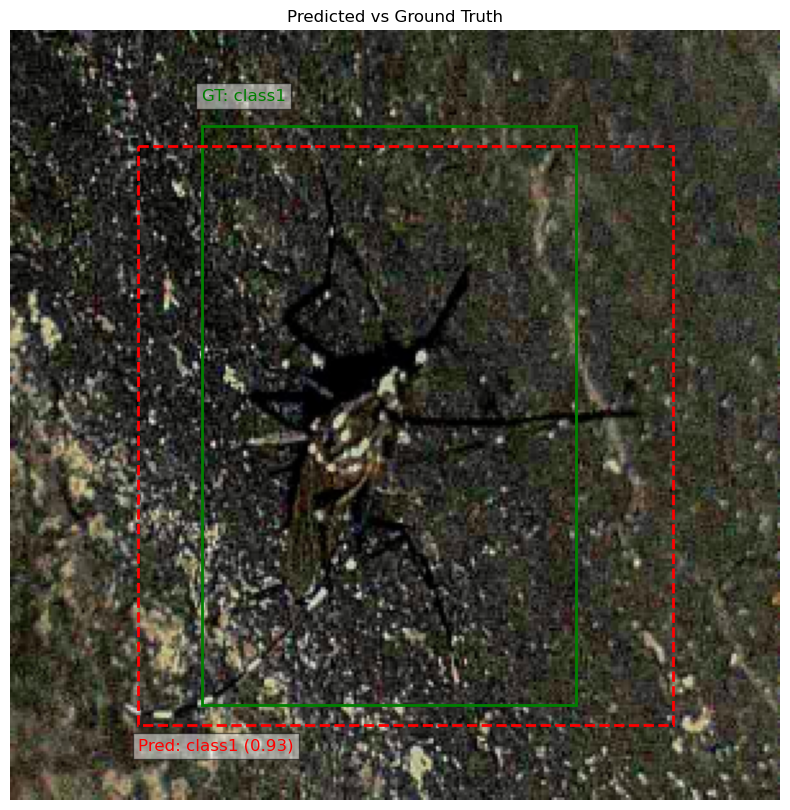

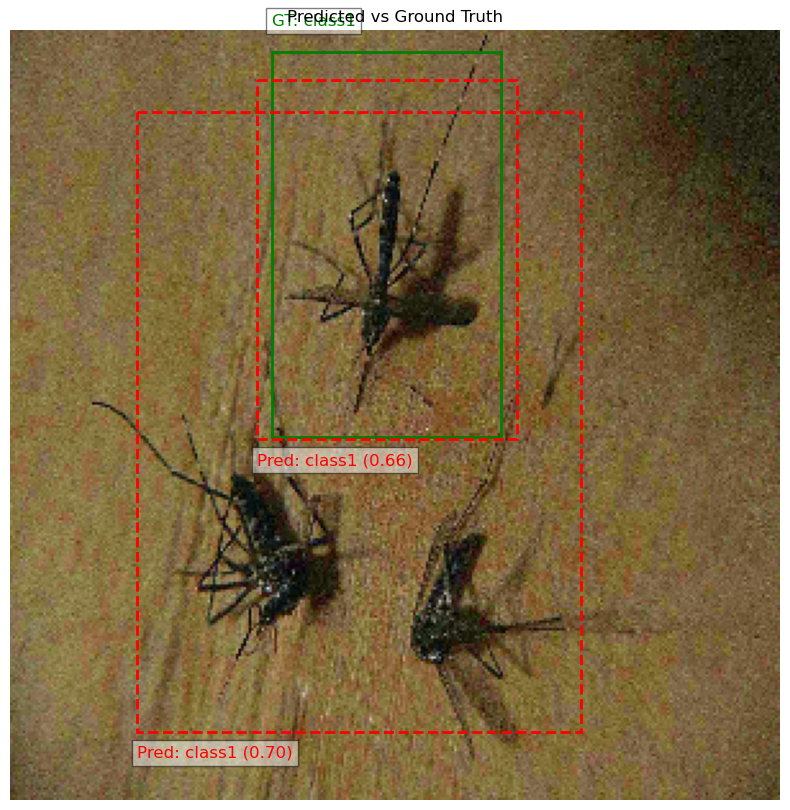

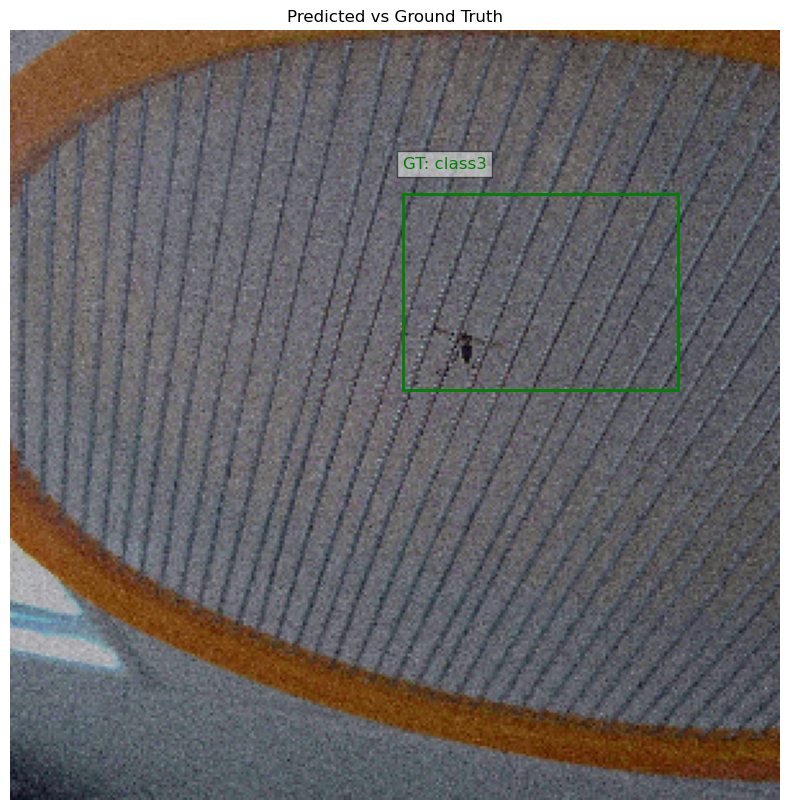

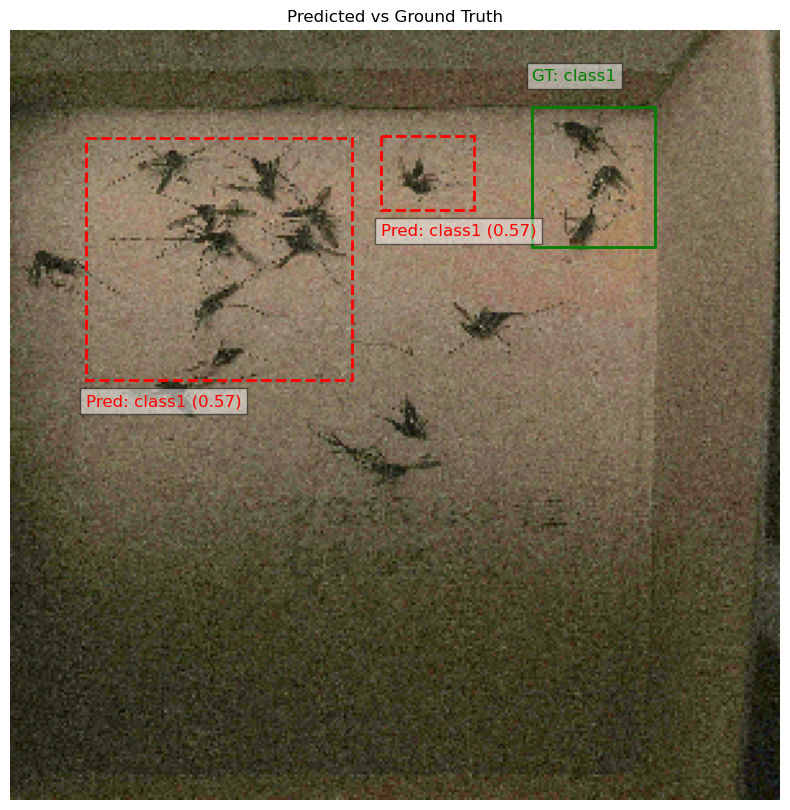

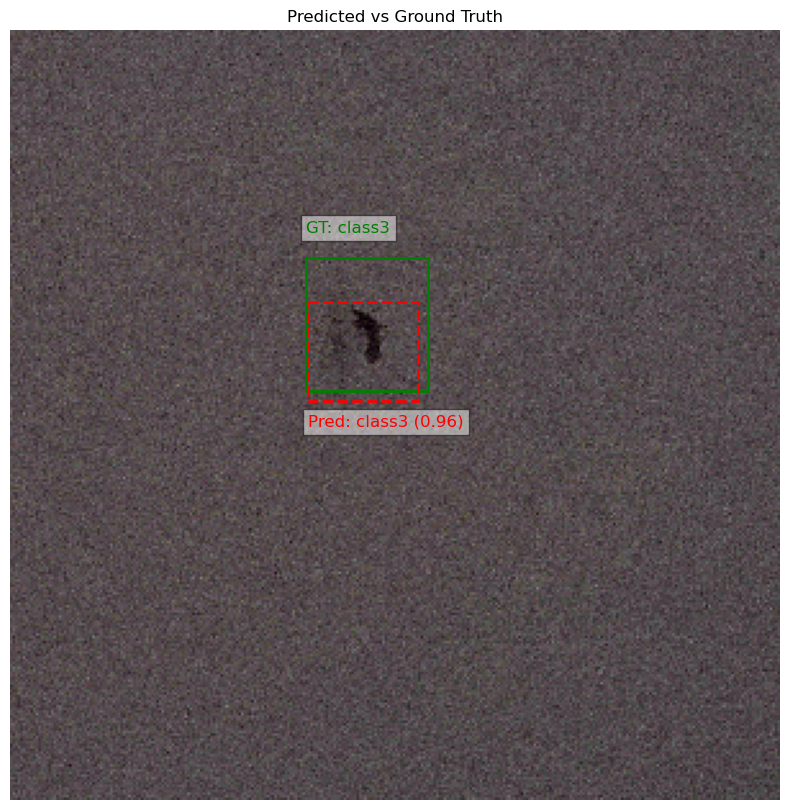

In [15]:
plot_predictions_vs_ground_truth(model, test_loader, device, class_labels, num_samples=10)

In [40]:
torch.save(model.state_dict(), "ssd_models/ssd_best_model.pth")

In [42]:
model2 = get_ssd_model(num_classes)

In [43]:
model2.load_state_dict(torch.load("ssd_models/ssd_best_model.pth"))

<All keys matched successfully>

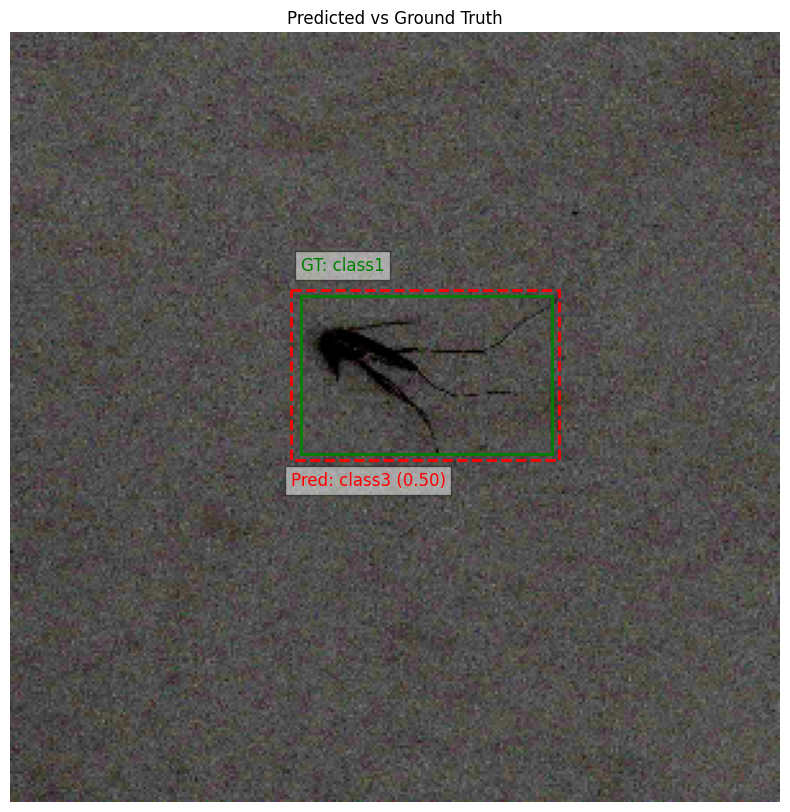

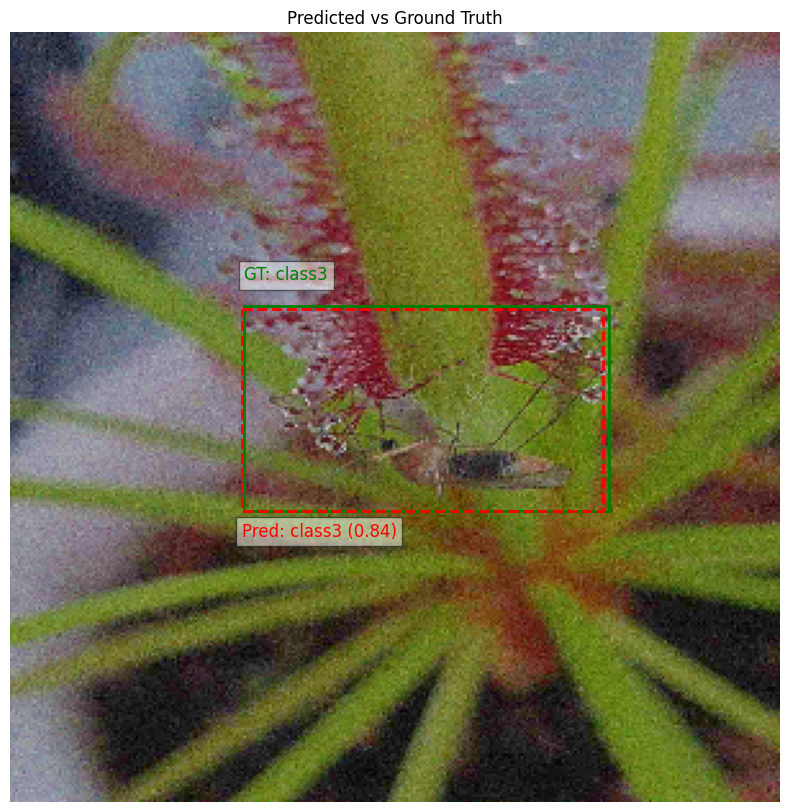

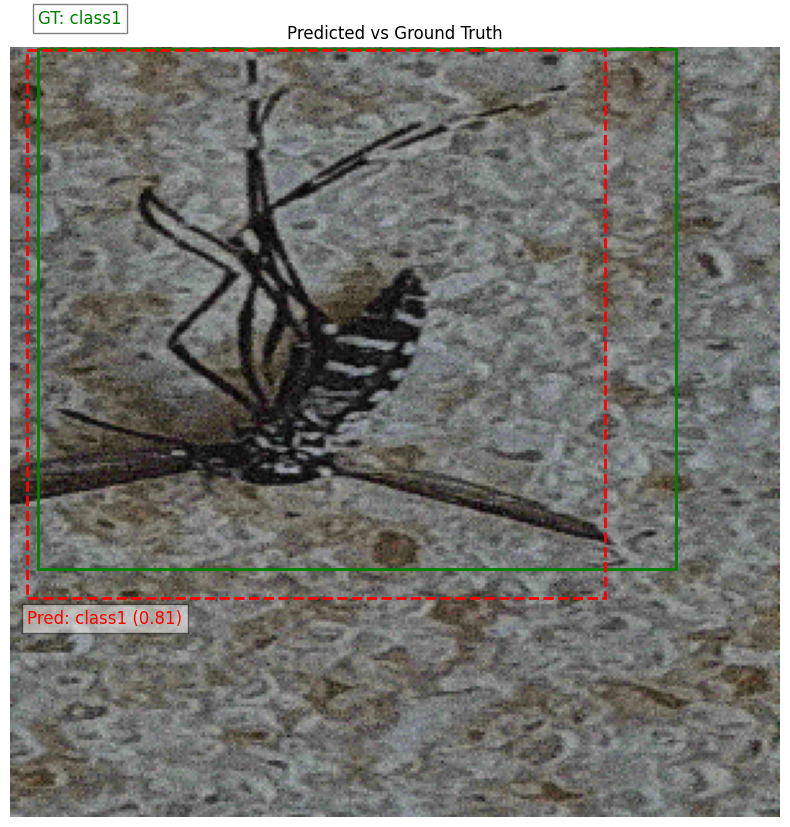

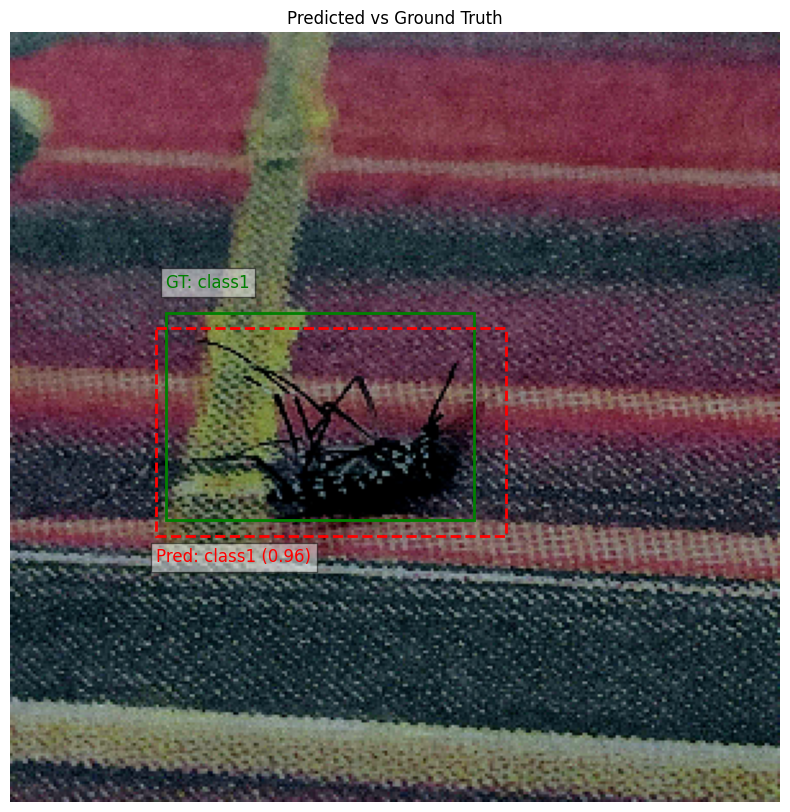

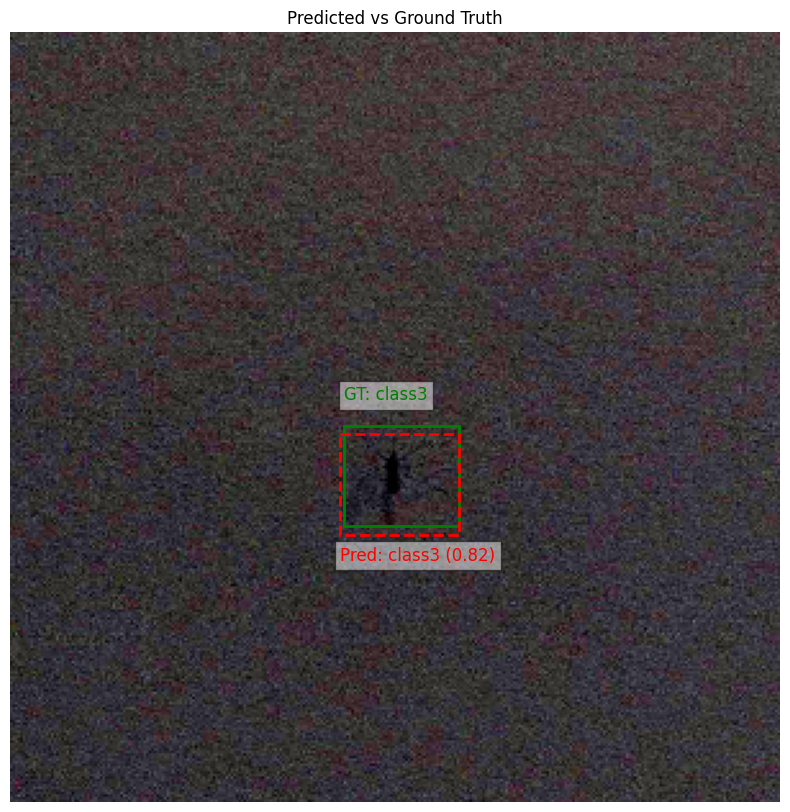

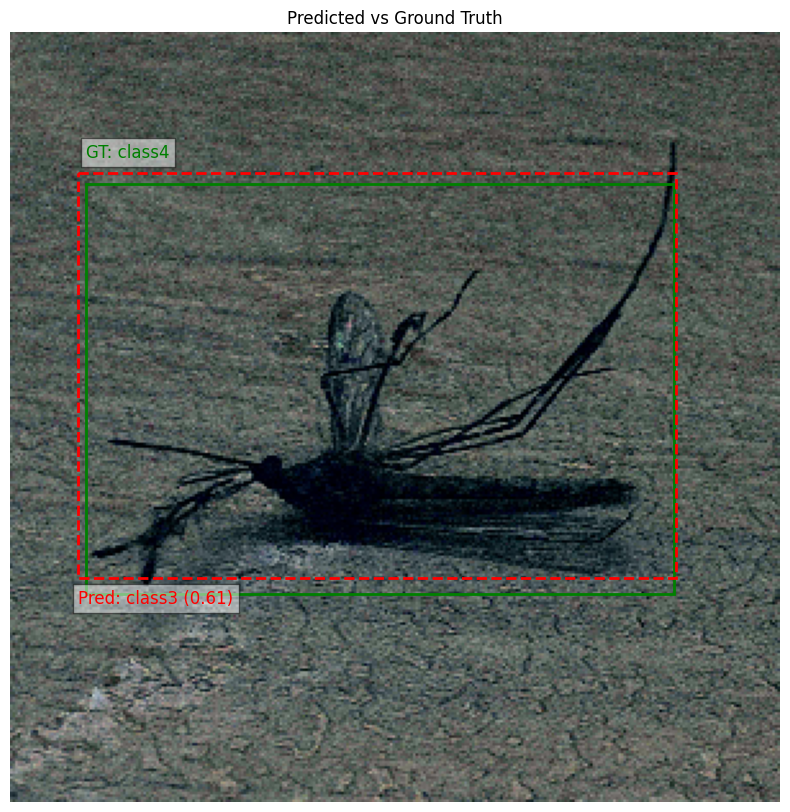

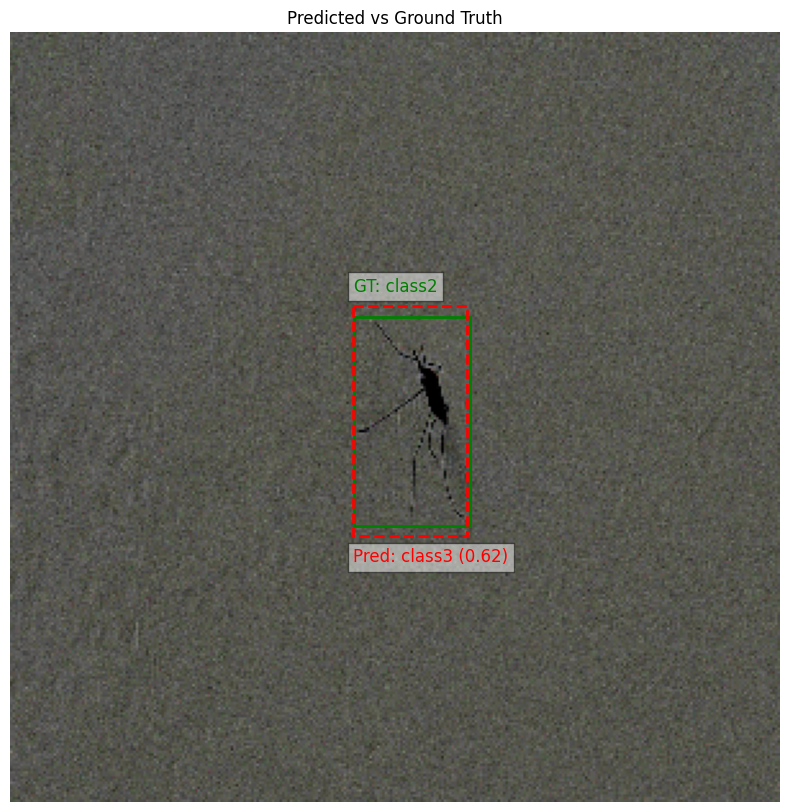

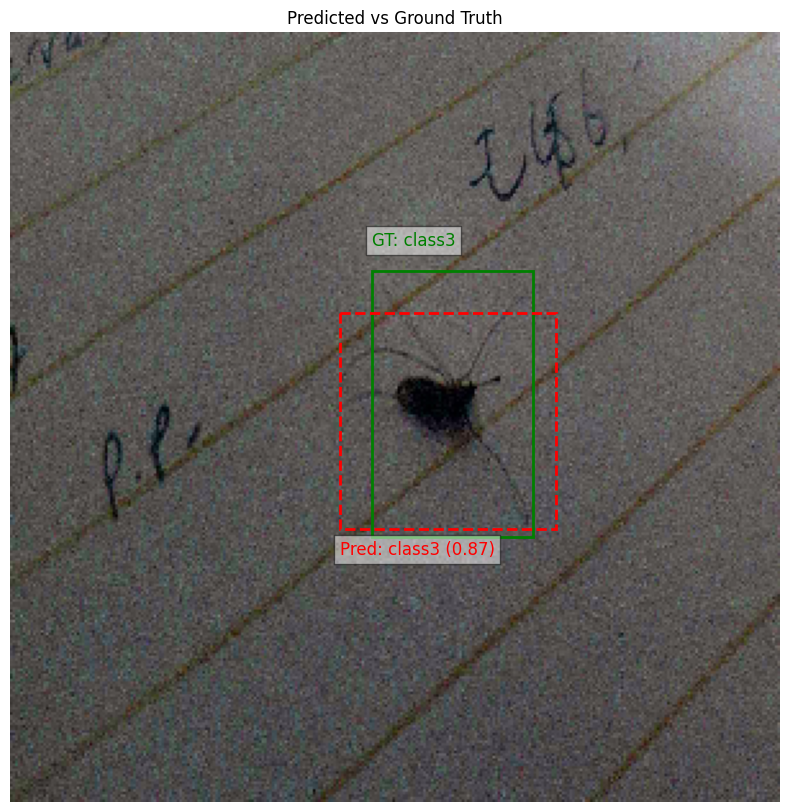

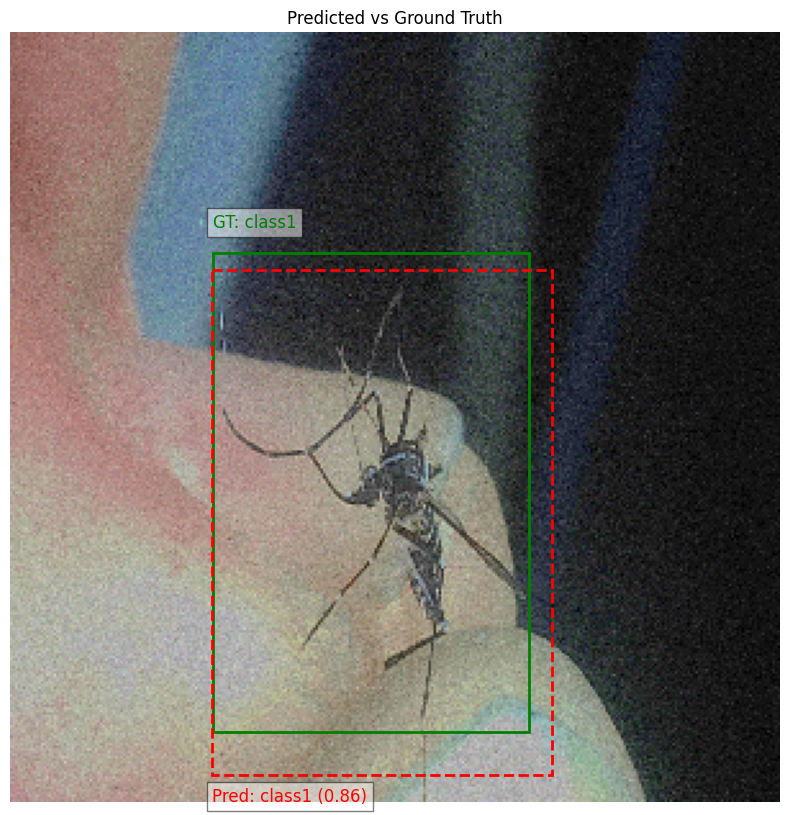

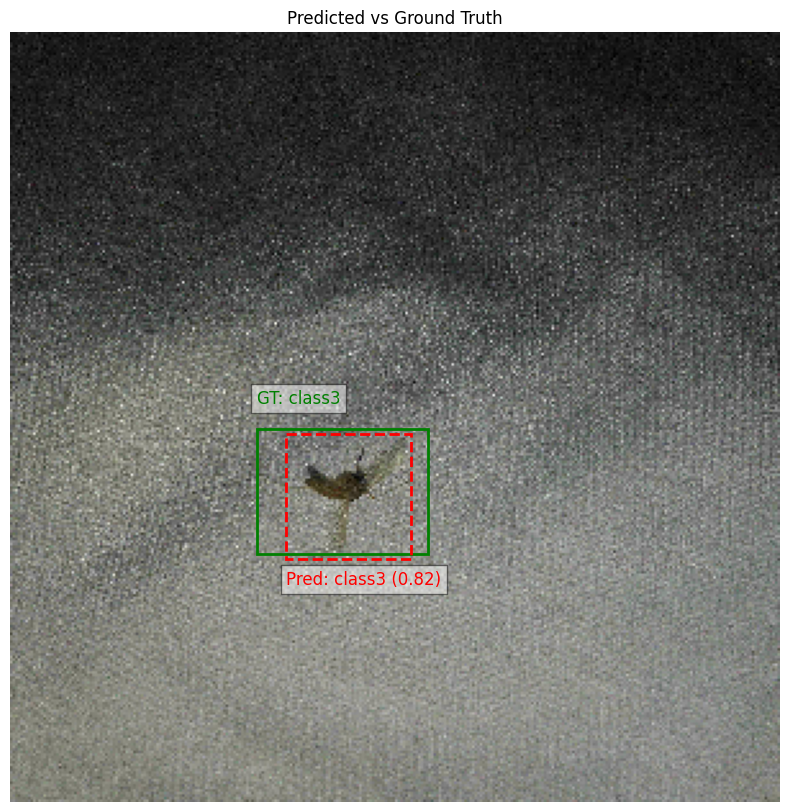

In [ ]:
model2 = model2.to(device)
plot_predictions_vs_ground_truth(model2, val_loader, device, class_labels, num_samples=10)

In [16]:
model3 = get_ssd_model(num_classes).to(device)
f1, map_score = evaluate_model(model3, val_loader, device, iou_threshold=0.5, score_threshold=0.5)
print(f"F1 Score: {f1:.4f}, mAP: {map_score:.4f}")

Evaluating: 100%|██████████| 142/142 [01:38<00:00,  1.44it/s]

F1 Score: 0.0056, mAP: 0.0261


In [17]:
# Example usage
f1, map_score = evaluate_model(model3, test_loader, device, iou_threshold=0.5, score_threshold=0.5)
print(f"F1 Score: {f1:.4f}, mAP: {map_score:.4f}")

Evaluating: 100%|██████████| 66/66 [00:45<00:00,  1.45it/s]

F1 Score: 0.0055, mAP: 0.0292
